# Annotations using clustering for cells for liver_s1

In [1]:
slide_id = "liver_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_liver_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 33795, 15404), (3, 16898, 7702)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (162628, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (162628, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (162628, 474)
      └── 'table_nuclei': AnnData (162628, 538)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 162628 × 474
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,5,0,0,0,0,5,365.359232,17.114219,cell_labels
1,aaaaaaab-1,10,0,0,0,0,10,514.600644,54.052033,cell_labels
2,aaaaaaac-1,2,0,0,0,0,2,115.058129,18.694688,cell_labels
3,aaaaaaad-1,3,0,0,0,0,3,316.048605,22.036251,cell_labels
4,aaaaaaae-1,9,0,0,0,0,9,337.407512,68.682659,cell_labels
...,...,...,...,...,...,...,...,...,...,...
162623,aaachldp-1,6,0,0,0,0,6,67.779534,6.005781,cell_labels
162624,aaachlea-1,28,0,0,0,0,28,838.054874,7.134688,cell_labels
162625,aaachleb-1,69,0,0,0,0,69,893.280970,12.553438,cell_labels
162626,aaachlec-1,49,0,0,0,0,49,1119.468634,51.252346,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
VSIG4,ENSG00000155659,Gene Expression,Unknown
VTN,ENSG00000109072,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 151385 × 538
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,64.573583,Vascular smooth muscle cell,14,1,4,1,1,Epithelial,Hepatocyte,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,60.396254,Glial cell,18,1,9,10,10,Epithelial,Cholangiocyte,normal_cell
aaaaaaap-1,nucleus_boundaries,morpho,aaaaaaap-1,21.178261,Granulocyte-monocyte progenitor,22,1,2,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaaaaba-1,nucleus_boundaries,morpho,aaaaaaba-1,25.919645,Treg cell,47,5,6,6,6,Endothelial,Endothelial,normal_cell
aaaaaabb-1,nucleus_boundaries,morpho,aaaaaabb-1,27.838863,Cycling late hemoglobin+ erythroblast,41,0,0,8,8,Epithelial,High_proliferating_hepatocyte,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaachldo-1,nucleus_boundaries,morpho,aaachldo-1,22.398003,Arterial EC,36,5,6,6,6,Endothelial,Endothelial,normal_cell
aaachlea-1,nucleus_boundaries,morpho,aaachlea-1,6.276579,Mast cell,14,1,2,4,4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaachleb-1,nucleus_boundaries,morpho,aaachleb-1,11.447431,Mast cell,32,2,3,3,3,T,T,normal_cell
aaachlec-1,nucleus_boundaries,morpho,aaachlec-1,47.842575,Arterial EC,39,2,3,3,3,T,T,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.011610,0.239732
ACE2,0.034196,0.413220
ACKR1,0.038246,0.440306
ACTA2,0.600384,1.734700
ACTG2,0.503842,1.536292
...,...,...
VSIG4,0.162674,0.926028
VTN,3.718240,3.207648
VWA5A,0.104894,0.718981
VWF,0.167161,0.929902


## 2. Preprocessing

<Axes: >

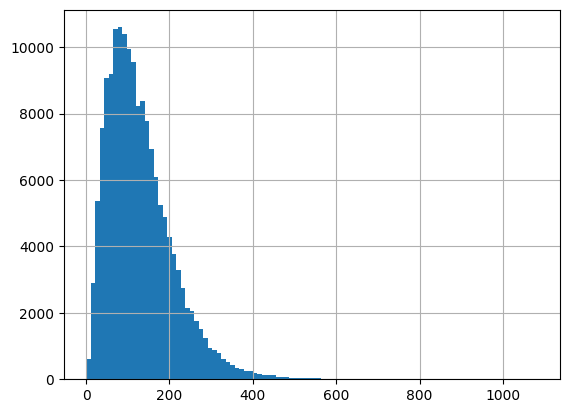

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

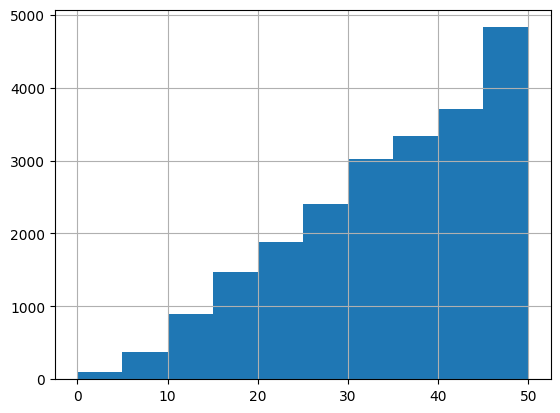

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 2841
Percentage of cells with less than 20 transcripts: 1.75%
-----
Number of cells with less than 15 transcripts: 1372
Percentage of cells with less than 15 transcripts: 0.84%
-----
Number of cells with less than 10 transcripts: 474
Percentage of cells with less than 10 transcripts: 0.29%
-----
Number total of cells: 162628


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

162016


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


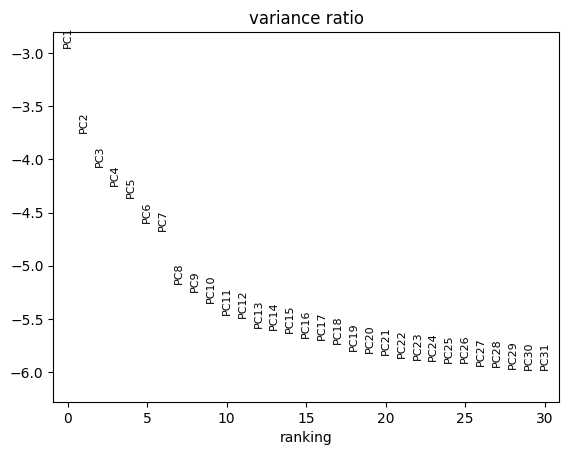

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 162016 × 474
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1517/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


In [90]:
sc.tl.leiden(adata_cells, resolution=0.8, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.8', neighbors_key='pca_n10_pcs16')

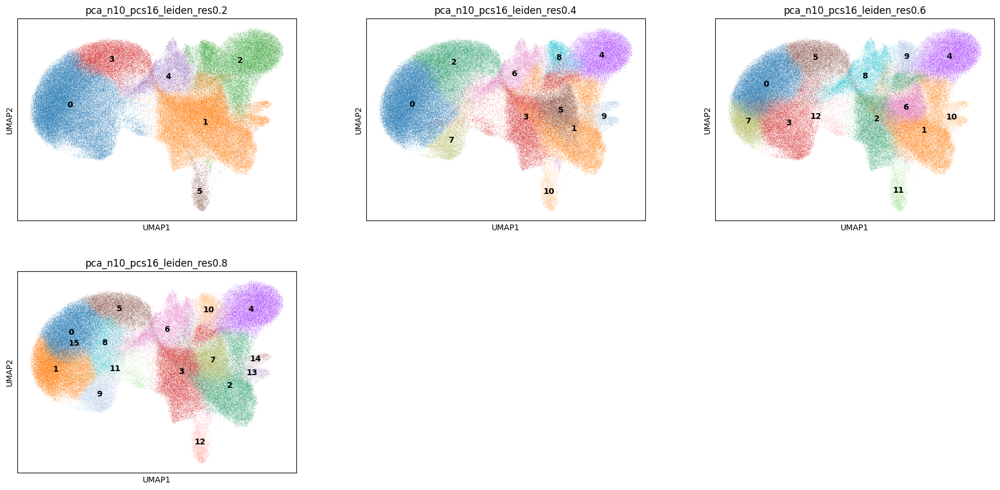

In [91]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.8'],
           ncols=3, legend_loc='on data')

In [95]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['2', '6', '0', '7', '3', ..., '4', '5', '8', '9', '10']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [96]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.8'].isin(['14']), 'refine_res'] = '11'

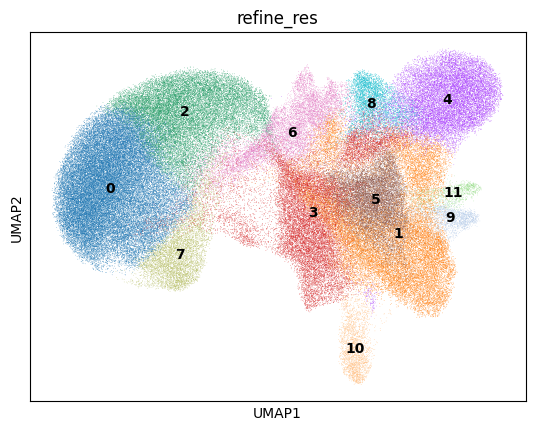

In [97]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [98]:
clustering_label = 'refine_res'

In [99]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

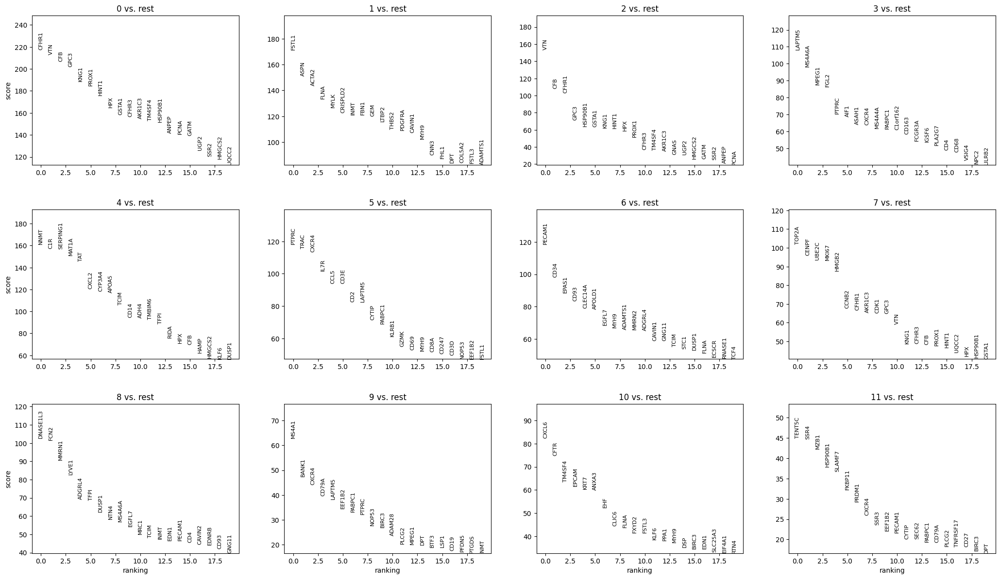

In [100]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [101]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [102]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [103]:
cluster_id = '0'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,cancer_cell,79.1
1,Epithelial,Hepatocyte,normal_cell,12.9
2,Epithelial,High_proliferating_hepatocyte,cancer_cell,6.9
3,NA,NA,NA,0.4
4,B,B,normal_cell,0.3


In [105]:
top_ranked_genes[cluster_id]

0    CFHR1
1      VTN
2      CFB
3     GPC3
4     KNG1
5    PROX1
6    HINT1
Name: 0, dtype: object

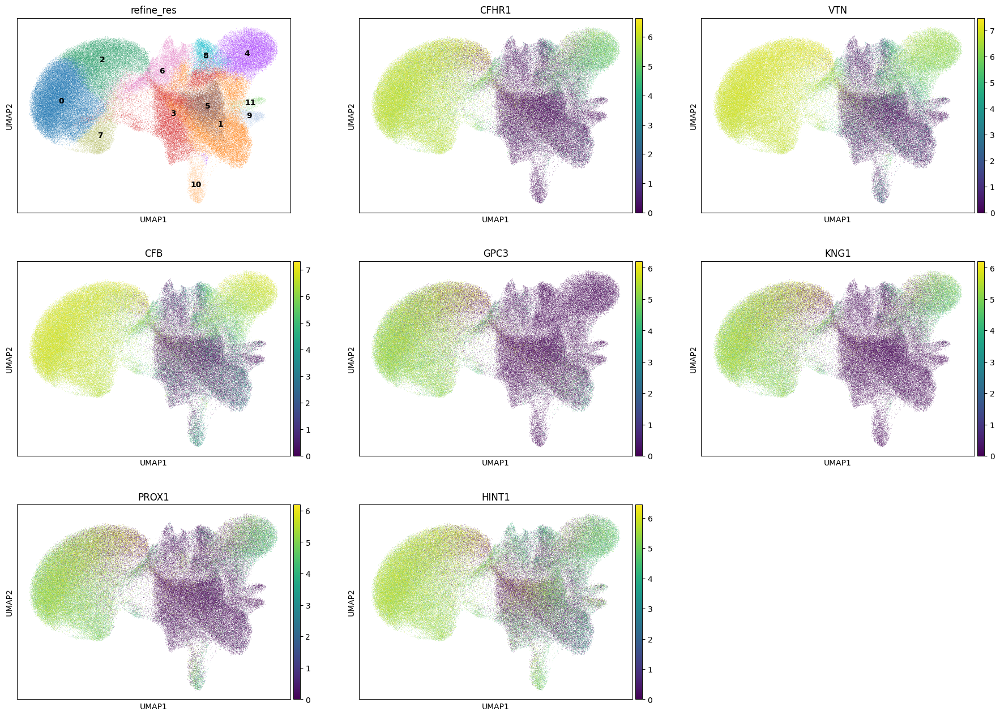

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 43077
Percentage of cells in cluster 0: 26.6


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.2. Cluster 1

In [109]:
cluster_id = '1'

In [110]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Myofibroblast,Myofibroblast,normal_cell,63.6
1,NA,NA,NA,10.7
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,10.5
3,T,T,normal_cell,6.1
4,Endothelial,Endothelial,normal_cell,4.6


In [111]:
top_ranked_genes[cluster_id]

0       FSTL1
1        ASPN
2       ACTA2
3        FLNA
4        MYLK
5    CRISPLD2
6        INMT
Name: 1, dtype: object

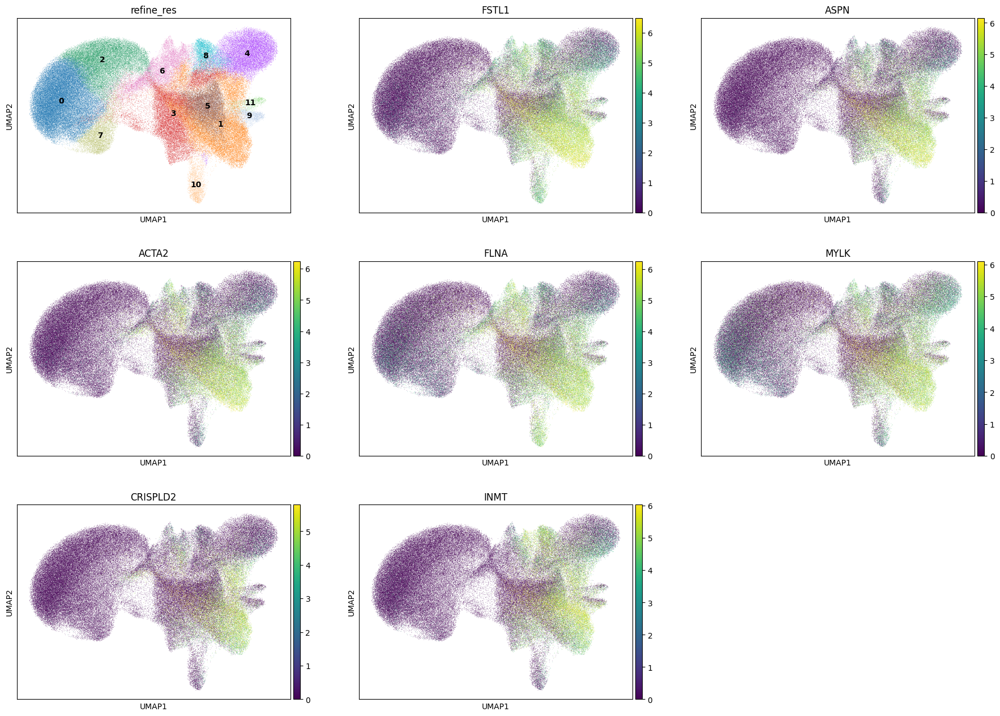

In [112]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [113]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 24485
Percentage of cells in cluster 1: 15.1


In [114]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast/Myofibroblast'

### 5.3. Cluster 2

In [115]:
cluster_id = '2'

In [116]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,57.1
1,Epithelial,High_proliferating_hepatocyte,cancer_cell,14.7
2,NA,NA,NA,13.0
3,Epithelial,Hepatocyte,cancer_cell,12.1
4,B,B,normal_cell,1.1


In [117]:
top_ranked_genes[cluster_id]

0        VTN
1        CFB
2      CFHR1
3       GPC3
4    HSP90B1
5      GSTA1
6       KNG1
Name: 2, dtype: object

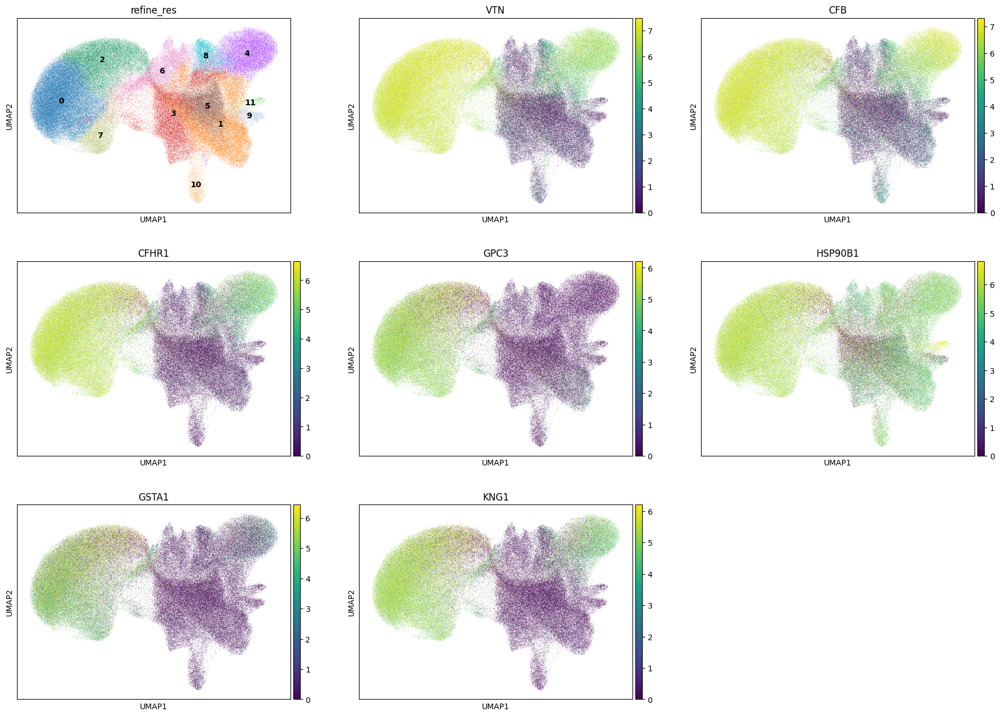

In [118]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [119]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 21615
Percentage of cells in cluster 2: 13.3


In [120]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.4. Cluster 3

In [121]:
cluster_id = '3'

In [122]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,58.1
1,NA,NA,NA,15.8
2,T,T,normal_cell,13.5
3,Epithelial,Hepatocyte,normal_cell,3.2
4,Myofibroblast,Myofibroblast,normal_cell,2.3


In [123]:
top_ranked_genes[cluster_id]

0    LAPTM5
1    MS4A6A
2     MPEG1
3      FGL2
4     PTPRC
5      AIF1
6     ASAH1
Name: 3, dtype: object

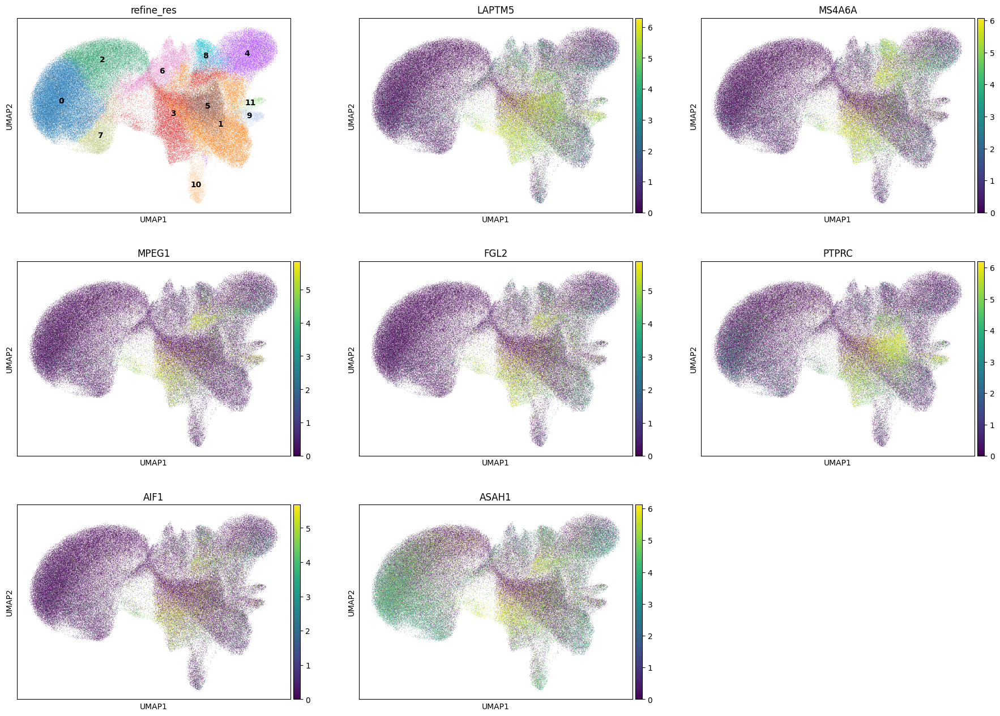

In [124]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [125]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 19922
Percentage of cells in cluster 3: 12.3


In [126]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.5. Cluster 4

In [127]:
cluster_id = '4'

In [128]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,85.1
1,NA,NA,NA,4.7
2,Myofibroblast,Myofibroblast,normal_cell,4.0
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.1
4,Endothelial,Endothelial,normal_cell,1.5


In [129]:
top_ranked_genes[cluster_id]

0        NNMT
1         C1R
2    SERPING1
3       MAT1A
4         TAT
5       CXCL2
6      CYP3A4
Name: 4, dtype: object

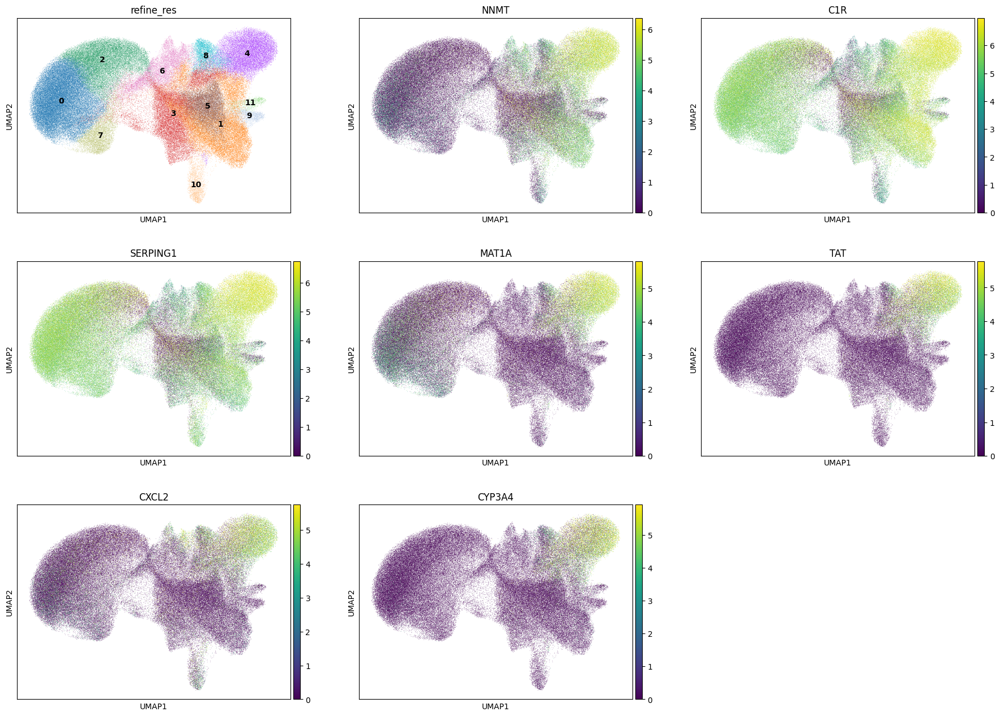

In [130]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [131]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 15754
Percentage of cells in cluster 4: 9.7


In [132]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.6. Cluster 5

In [133]:
cluster_id = '5'

In [134]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,89.4
1,NA,NA,NA,3.2
2,Myofibroblast,Myofibroblast,normal_cell,2.9
3,B,B,normal_cell,2.1
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.3


In [135]:
top_ranked_genes[cluster_id]

0    PTPRC
1     TRAC
2    CXCR4
3     IL7R
4     CCL5
5     CD3E
6      CD2
Name: 5, dtype: object

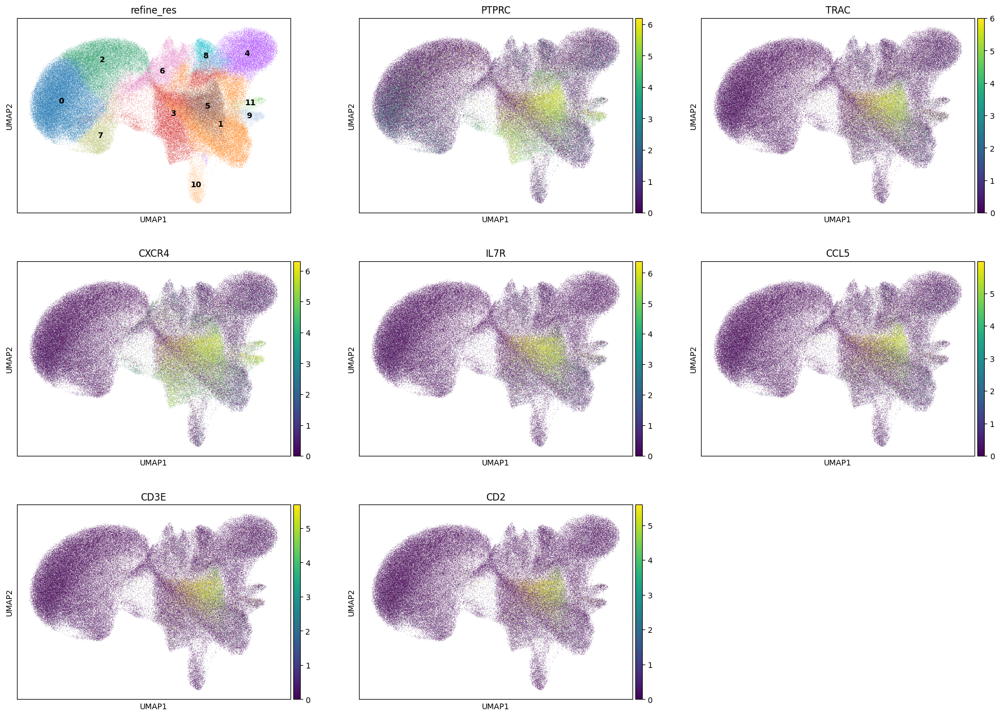

In [136]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [137]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 12435
Percentage of cells in cluster 5: 7.7


In [138]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.7. Cluster 6

In [139]:
cluster_id = '6'

In [140]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,69.4
1,Myofibroblast,Myofibroblast,normal_cell,13.3
2,Epithelial,Hepatocyte,normal_cell,4.6
3,NA,NA,NA,4.3
4,Epithelial,Hepatocyte,cancer_cell,3.7


In [141]:
top_ranked_genes[cluster_id]

0     PECAM1
1       CD34
2      EPAS1
3       CD93
4    CLEC14A
5     APOLD1
6      EGFL7
Name: 6, dtype: object

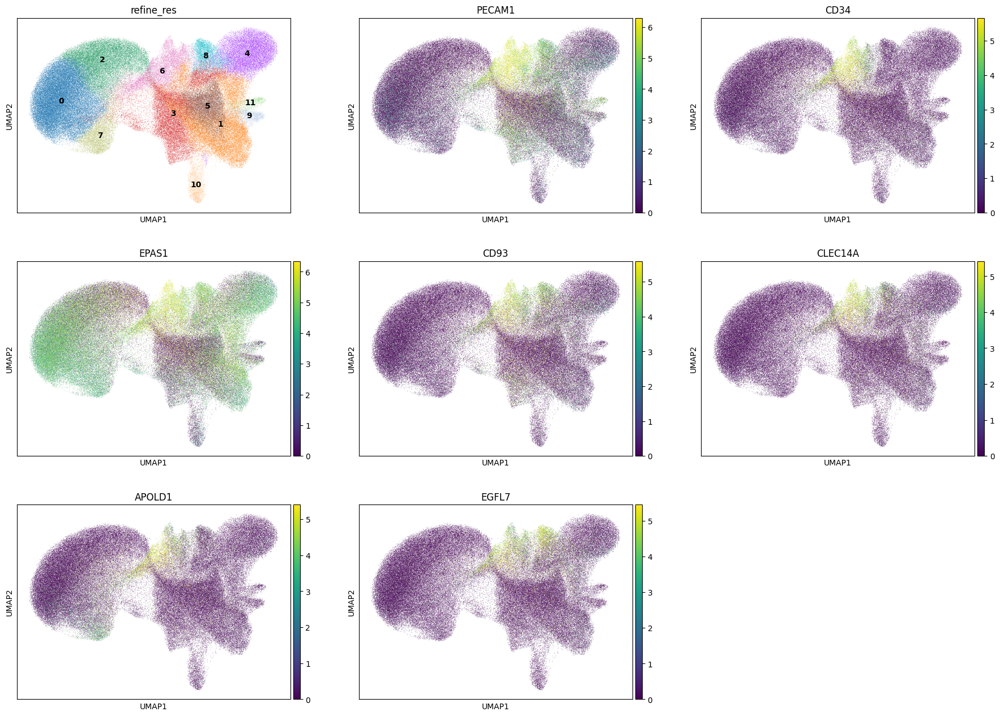

In [142]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [143]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 8937
Percentage of cells in cluster 6: 5.5


In [144]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.8. Cluster 7

In [145]:
cluster_id = '7'

In [146]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,High_proliferating_hepatocyte,cancer_cell,80.3
1,Epithelial,Hepatocyte,cancer_cell,14.8
2,Epithelial,Hepatocyte,normal_cell,3.1
3,NA,NA,NA,0.9
4,Epithelial,Cholangiocyte,normal_cell,0.3


In [147]:
top_ranked_genes[cluster_id]

0    TOP2A
1    CENPF
2    UBE2C
3    MKI67
4    HMGB2
5    CCNB2
6    CFHR1
Name: 7, dtype: object

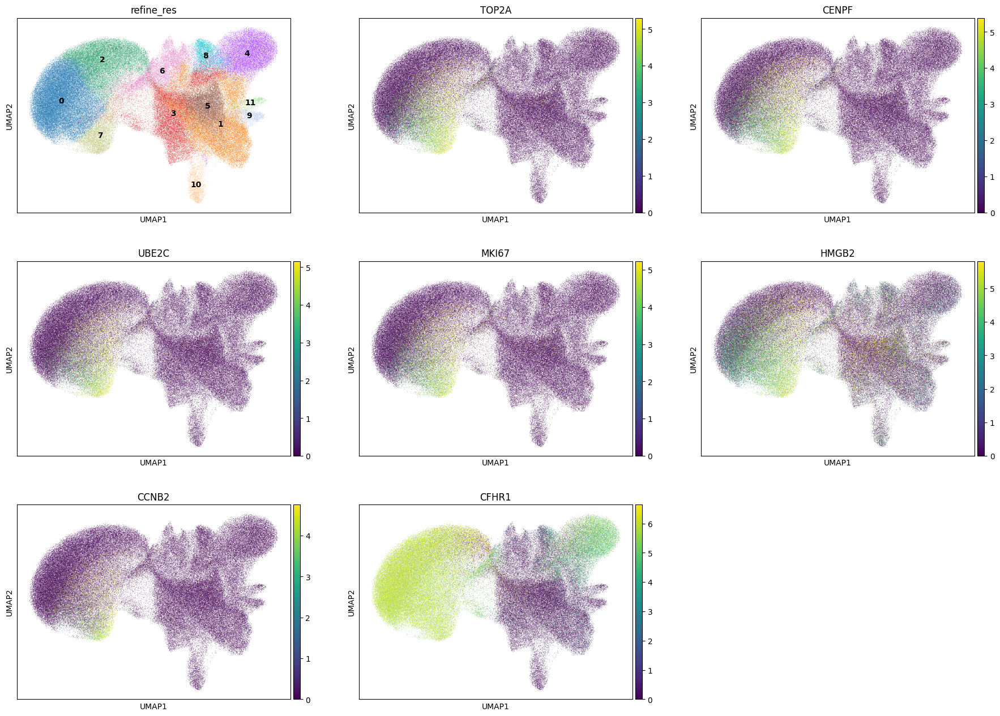

In [148]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [149]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 5967
Percentage of cells in cluster 7: 3.7


In [150]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'High_proliferating_hepatocyte'

### 5.9. Cluster 8

In [151]:
cluster_id = '8'

In [152]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,78.5
1,Epithelial,Hepatocyte,normal_cell,6.8
2,Myofibroblast,Myofibroblast,normal_cell,5.1
3,NA,NA,NA,4.9
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.4


In [153]:
top_ranked_genes[cluster_id]

0    DNASE1L3
1        FCN2
2       MMRN1
3       LYVE1
4      ADGRL4
5        TFPI
6       DUSP1
Name: 8, dtype: object

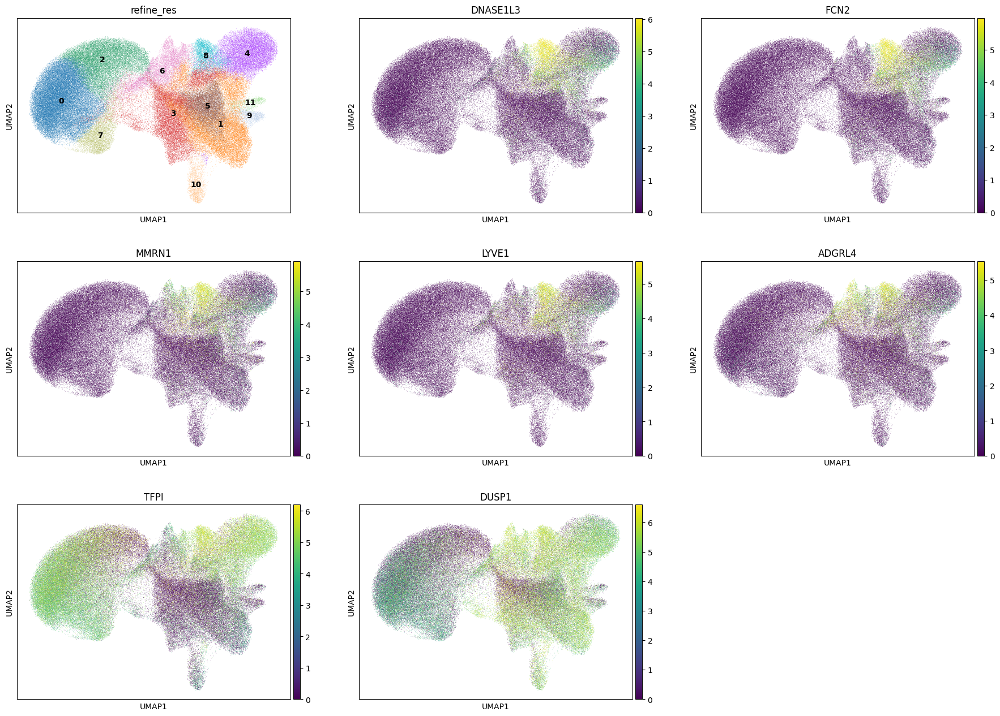

In [154]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [155]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 4498
Percentage of cells in cluster 8: 2.8


In [156]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.10. Cluster 9

In [157]:
cluster_id = '9'

In [158]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,90.6
1,T,T,normal_cell,4.1
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.6
3,NA,NA,NA,1.4
4,Myofibroblast,Myofibroblast,normal_cell,1.4


In [159]:
top_ranked_genes[cluster_id]

0     MS4A1
1     BANK1
2     CXCR4
3     CD79A
4    LAPTM5
5    EEF1B2
6    PABPC1
Name: 9, dtype: object

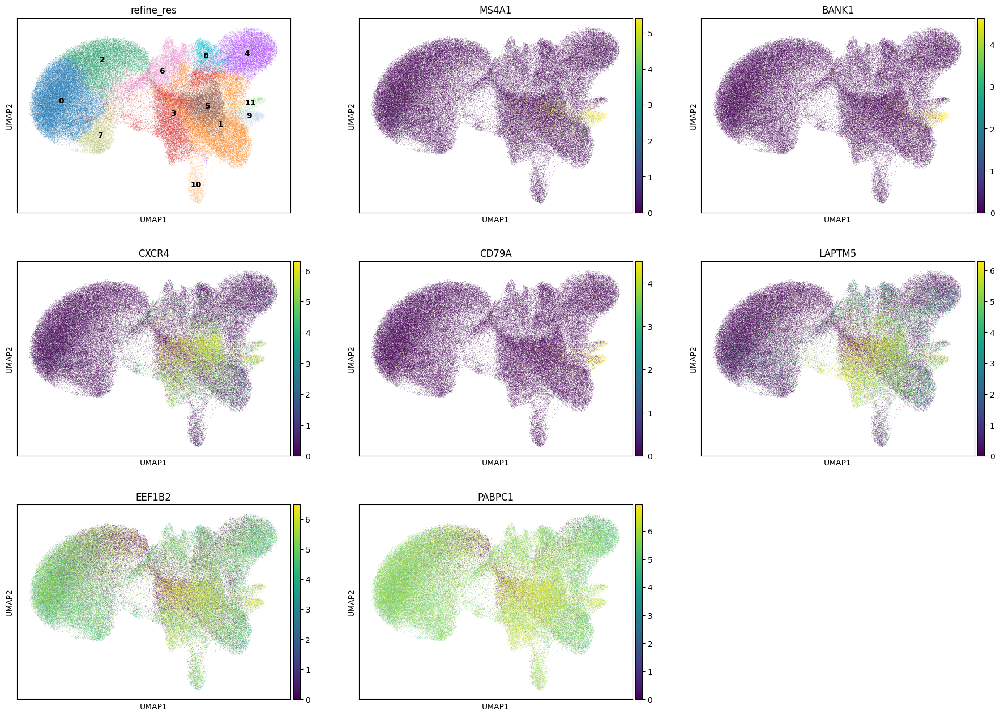

In [160]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [161]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 1700
Percentage of cells in cluster 9: 1.0


In [162]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.11. Cluster 10

In [163]:
cluster_id = '10'

In [164]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cholangiocyte,normal_cell,92.2
1,Myofibroblast,Myofibroblast,normal_cell,2.0
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.7
3,NA,NA,NA,1.4
4,Epithelial,Hepatocyte,normal_cell,1.2


In [165]:
top_ranked_genes[cluster_id]

0     CXCL6
1      CFTR
2    TM4SF4
3     EPCAM
4      KRT7
5     ANXA3
6       EHF
Name: 10, dtype: object

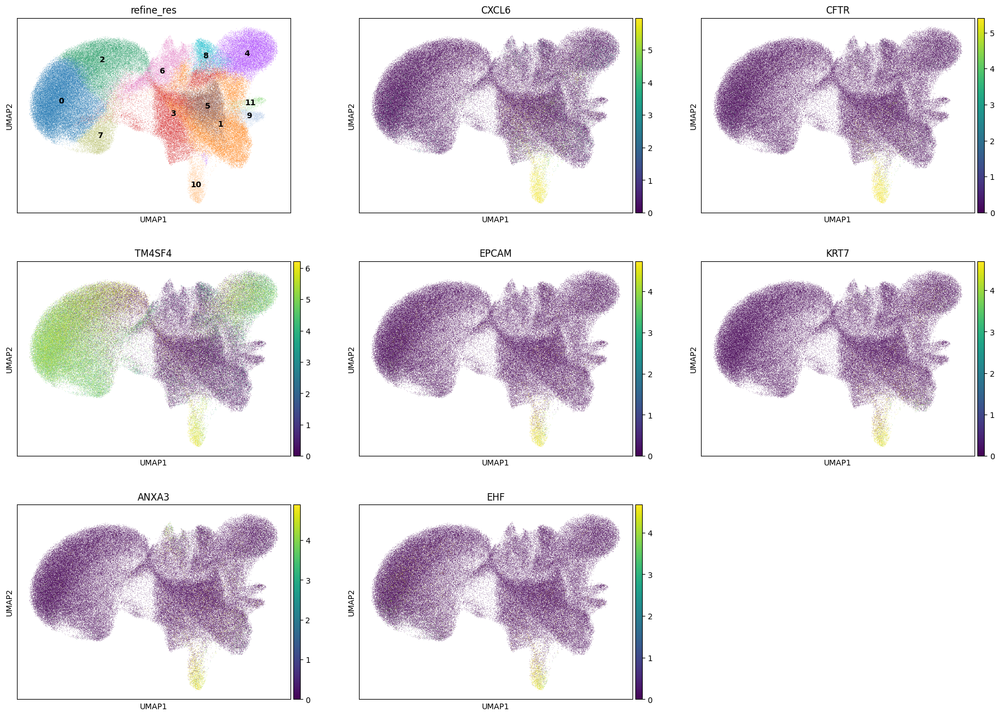

In [166]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [167]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 2533
Percentage of cells in cluster 10: 1.6


In [168]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Cholangiocyte'

### 5.12. Cluster 11

In [169]:
cluster_id = '11'

In [170]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,72.4
1,T,T,normal_cell,7.3
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.5
3,B,B,normal_cell,5.3
4,Myofibroblast,Myofibroblast,normal_cell,4.8


In [171]:
top_ranked_genes[cluster_id]

0     TENT5C
1       SSR4
2       MZB1
3    HSP90B1
4     SLAMF7
5     FKBP11
6      PRDM1
Name: 11, dtype: object

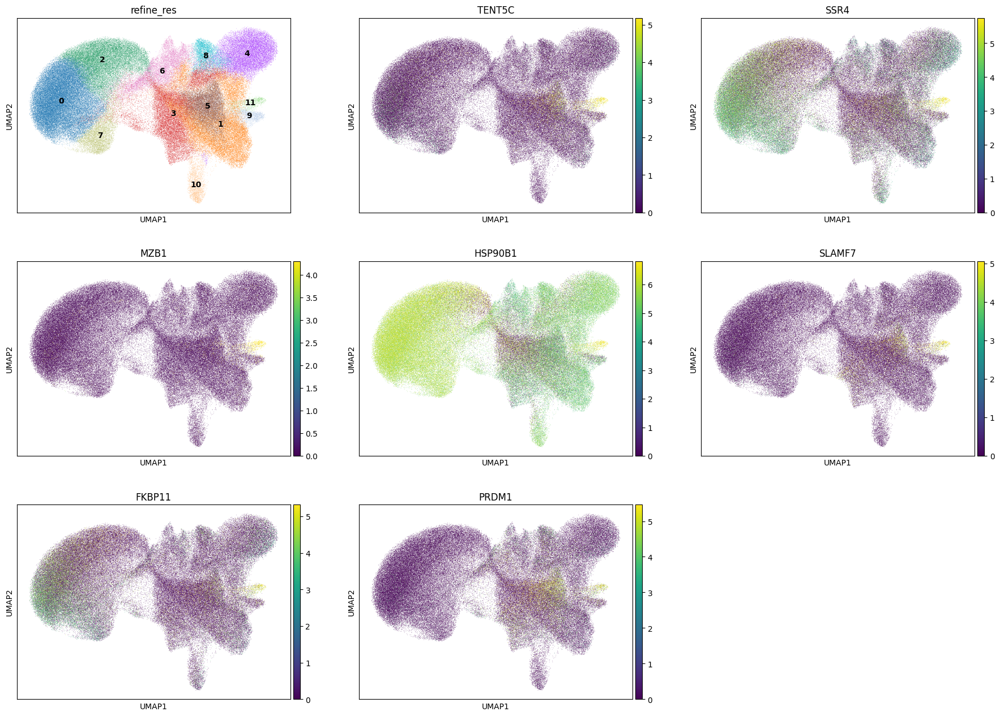

In [172]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [173]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 1093
Percentage of cells in cluster 11: 0.7


In [174]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

## 6. Cancer cells

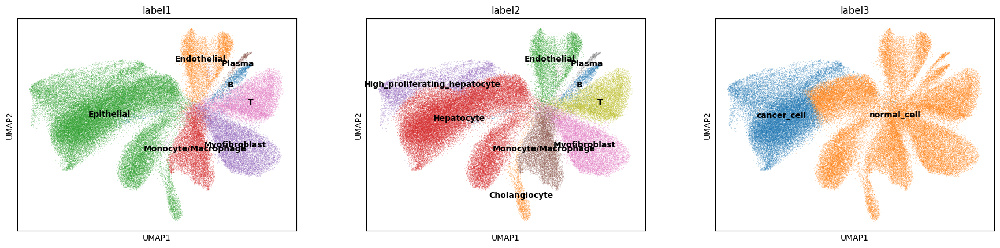

In [177]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

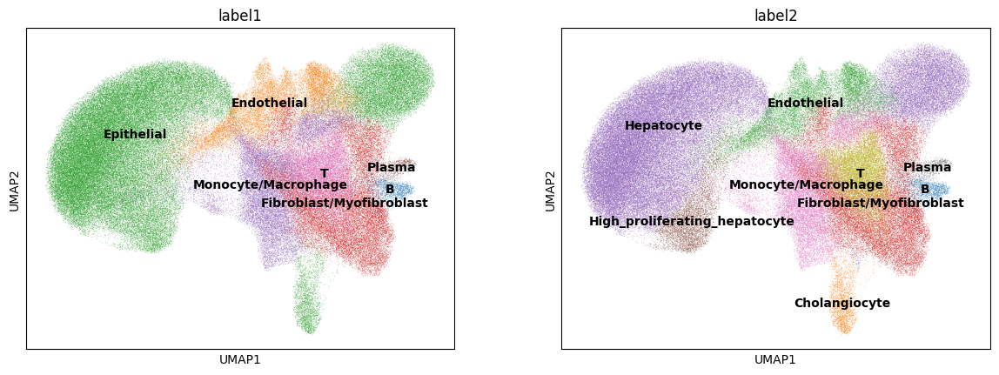

In [178]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [179]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'] == 'Epithelial', 'label3'] = 'cancer_cell'

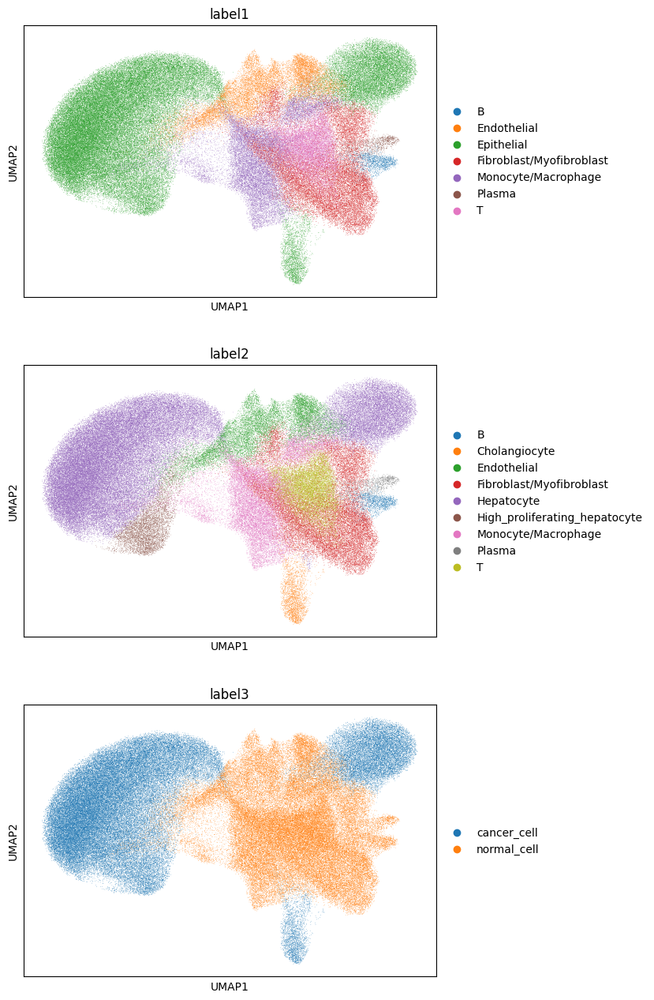

In [180]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [181]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,pca_n10_pcs16_leiden_res0.8,label3
15,aaaaaaap-1,34,0,0,0,0,34,601.977991,23.255470,cell_labels,3,2,5,2,Epithelial,Hepatocyte,5,cancer_cell
16,aaaaaaba-1,99,0,0,0,0,99,301.779230,25.558438,cell_labels,4,6,8,6,Endothelial,Endothelial,6,normal_cell
17,aaaaaabb-1,149,0,0,0,0,149,225.736102,29.938595,cell_labels,0,0,0,0,Epithelial,Hepatocyte,0,cancer_cell
18,aaaaaabc-1,85,0,0,0,0,85,101.240316,43.033908,cell_labels,3,2,5,2,Epithelial,Hepatocyte,5,cancer_cell
19,aaaaaabd-1,157,0,0,0,0,157,132.623911,82.816566,cell_labels,0,0,7,0,Epithelial,Hepatocyte,1,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162622,aaachldo-1,49,0,0,0,0,49,92.254222,24.384376,cell_labels,4,6,8,6,Endothelial,Endothelial,6,normal_cell
162624,aaachlea-1,28,0,0,0,0,28,838.054874,7.134688,cell_labels,1,3,2,3,Monocyte/Macrophage,Monocyte/Macrophage,3,normal_cell
162625,aaachleb-1,69,0,0,0,0,69,893.280970,12.553438,cell_labels,1,5,6,5,T,T,7,normal_cell
162626,aaachlec-1,49,0,0,0,0,49,1119.468634,51.252346,cell_labels,1,5,6,5,T,T,7,normal_cell


In [182]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")